Import Libraries

In [9]:
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

In [10]:
mSeed = 99
random.seed(mSeed)
torch.manual_seed(mSeed)
torch.use_deterministic_algorithms


<function torch.use_deterministic_algorithms(mode: bool, *, warn_only: bool = False) -> None>

Parameters

In [19]:
# Root directory for dataset
dataroot = "F:/SunsetPredictor/Data"

# Number of workers for dataloader
workers = 8

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 200

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

In [20]:
if torch.cuda.is_available():
    device = torch.device("cuda")
    print("CUDA is available! Using GPU.")
else:
    device = torch.device("cpu")
    print("CUDA is not available. Using CPU.")

print("Device:", device)


CUDA is available! Using GPU.
Device: cuda


In [21]:
dset.ImageFolder(root = "f:/SunsetPredictor/Data")

Dataset ImageFolder
    Number of datapoints: 5167
    Root location: f:/SunsetPredictor/Data

In [22]:
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))


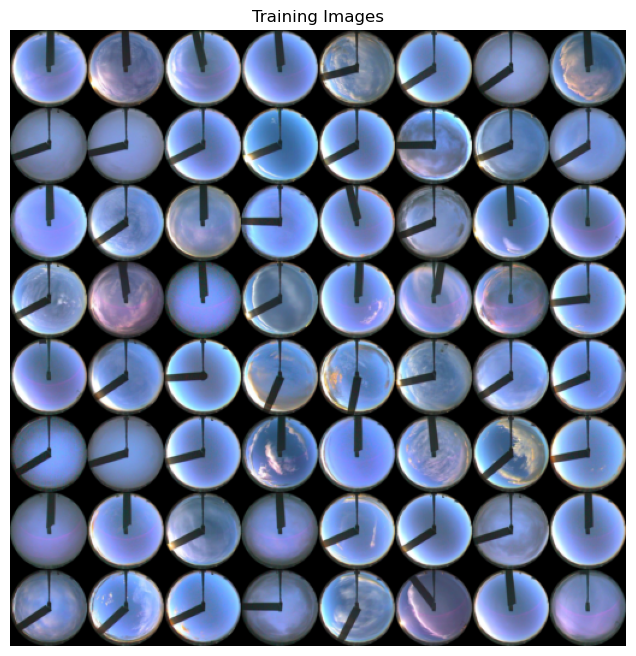

In [23]:
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=0, normalize=True).cpu(),(1,2,0)))
plt.show()

In [24]:
# custom weights initialization called on ``netG`` and ``netD``
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [25]:

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. ``(ngf*8) x 4 x 4``
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. ``(ngf*4) x 8 x 8``
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 16 x 16``
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. ``(ngf) x 32 x 32``
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 64 x 64``
        )

    def forward(self, input):
        return self.main(input)

In [26]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
#  to ``mean=0``, ``stdev=0.02``.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [27]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is ``(nc) x 64 x 64``
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf) x 32 x 32``
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2) x 16 x 16``
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4) x 8 x 8``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8) x 4 x 4``
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [28]:
netD = Discriminator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [29]:
# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [30]:
# Training Loop
from tqdm import tqdm
# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in tqdm(range(num_epochs)):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...


  0%|          | 0/200 [00:00<?, ?it/s]

[0/200][0/41]	Loss_D: 1.9697	Loss_G: 2.1838	D(x): 0.2428	D(G(z)): 0.3226 / 0.1492


c:\ProgramData\anaconda3\lib\site-packages\torch\nn\modules\conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\cudnn\Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,
  0%|          | 1/200 [00:31<1:43:18, 31.15s/it]

[1/200][0/41]	Loss_D: 0.0262	Loss_G: 8.8781	D(x): 0.9900	D(G(z)): 0.0150 / 0.0002


  1%|          | 2/200 [01:01<1:41:50, 30.86s/it]

[2/200][0/41]	Loss_D: 0.0322	Loss_G: 10.4835	D(x): 0.9991	D(G(z)): 0.0306 / 0.0000


  2%|▏         | 3/200 [01:32<1:40:51, 30.72s/it]

[3/200][0/41]	Loss_D: 8.5567	Loss_G: 31.0098	D(x): 1.0000	D(G(z)): 0.9997 / 0.0000


  2%|▏         | 4/200 [02:02<1:40:14, 30.69s/it]

[4/200][0/41]	Loss_D: 0.0014	Loss_G: 38.7333	D(x): 0.9987	D(G(z)): 0.0000 / 0.0000


  2%|▎         | 5/200 [02:33<1:39:37, 30.65s/it]

[5/200][0/41]	Loss_D: 0.0000	Loss_G: 38.5156	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


  3%|▎         | 6/200 [03:04<1:38:56, 30.60s/it]

[6/200][0/41]	Loss_D: 0.0000	Loss_G: 38.2689	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


  4%|▎         | 7/200 [03:34<1:38:25, 30.60s/it]

[7/200][0/41]	Loss_D: 0.0000	Loss_G: 37.9786	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


  4%|▍         | 8/200 [04:05<1:37:50, 30.58s/it]

[8/200][0/41]	Loss_D: 0.0000	Loss_G: 37.5851	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


  4%|▍         | 9/200 [04:35<1:37:21, 30.58s/it]

[9/200][0/41]	Loss_D: 0.0000	Loss_G: 37.1160	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


  5%|▌         | 10/200 [05:06<1:36:47, 30.57s/it]

[10/200][0/41]	Loss_D: 0.0001	Loss_G: 38.9793	D(x): 0.9999	D(G(z)): 0.0000 / 0.0000


  6%|▌         | 11/200 [05:36<1:36:17, 30.57s/it]

[11/200][0/41]	Loss_D: 0.0512	Loss_G: 44.7181	D(x): 0.9838	D(G(z)): 0.0000 / 0.0000


  6%|▌         | 12/200 [06:07<1:35:47, 30.57s/it]

[12/200][0/41]	Loss_D: 0.0001	Loss_G: 43.8646	D(x): 0.9999	D(G(z)): 0.0000 / 0.0000


  6%|▋         | 13/200 [06:37<1:35:10, 30.54s/it]

[13/200][0/41]	Loss_D: 0.0000	Loss_G: 43.7862	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


  7%|▋         | 14/200 [07:08<1:34:49, 30.59s/it]

[14/200][0/41]	Loss_D: 0.0000	Loss_G: 43.5154	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


  8%|▊         | 15/200 [07:39<1:34:12, 30.56s/it]

[15/200][0/41]	Loss_D: 0.0000	Loss_G: 42.3587	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000


  8%|▊         | 16/200 [08:09<1:33:43, 30.56s/it]

[16/200][0/41]	Loss_D: 4.3631	Loss_G: 21.1263	D(x): 0.9999	D(G(z)): 0.8719 / 0.0000


  8%|▊         | 17/200 [08:40<1:33:18, 30.59s/it]

[17/200][0/41]	Loss_D: 2.9035	Loss_G: 4.7750	D(x): 0.1886	D(G(z)): 0.0016 / 0.0114


  9%|▉         | 18/200 [09:11<1:33:01, 30.67s/it]

[18/200][0/41]	Loss_D: 1.9841	Loss_G: 1.2341	D(x): 0.2701	D(G(z)): 0.0130 / 0.3488


 10%|▉         | 19/200 [09:41<1:32:31, 30.67s/it]

[19/200][0/41]	Loss_D: 0.8927	Loss_G: 4.0537	D(x): 0.9095	D(G(z)): 0.4936 / 0.0404


 10%|█         | 20/200 [10:12<1:31:50, 30.61s/it]

[20/200][0/41]	Loss_D: 0.8862	Loss_G: 4.4836	D(x): 0.9138	D(G(z)): 0.5118 / 0.0218


 10%|█         | 21/200 [10:42<1:31:15, 30.59s/it]

[21/200][0/41]	Loss_D: 1.7681	Loss_G: 1.0869	D(x): 0.2758	D(G(z)): 0.0315 / 0.3892


 11%|█         | 22/200 [11:13<1:30:39, 30.56s/it]

[22/200][0/41]	Loss_D: 1.2698	Loss_G: 5.7154	D(x): 0.9486	D(G(z)): 0.6624 / 0.0061


 12%|█▏        | 23/200 [11:44<1:30:12, 30.58s/it]

[23/200][0/41]	Loss_D: 1.0350	Loss_G: 1.3325	D(x): 0.4886	D(G(z)): 0.0621 / 0.3211


 12%|█▏        | 24/200 [12:15<1:30:25, 30.83s/it]

[24/200][0/41]	Loss_D: 1.2953	Loss_G: 0.9459	D(x): 0.3365	D(G(z)): 0.0157 / 0.4364


 12%|█▎        | 25/200 [12:46<1:29:47, 30.79s/it]

[25/200][0/41]	Loss_D: 0.5366	Loss_G: 2.7055	D(x): 0.8682	D(G(z)): 0.2911 / 0.0846


 13%|█▎        | 26/200 [13:16<1:29:04, 30.71s/it]

[26/200][0/41]	Loss_D: 0.7711	Loss_G: 1.4384	D(x): 0.5281	D(G(z)): 0.0509 / 0.2814


 14%|█▎        | 27/200 [13:47<1:28:29, 30.69s/it]

[27/200][0/41]	Loss_D: 1.0156	Loss_G: 1.0816	D(x): 0.4469	D(G(z)): 0.0597 / 0.3786


 14%|█▍        | 28/200 [14:17<1:27:54, 30.67s/it]

[28/200][0/41]	Loss_D: 0.4433	Loss_G: 2.7240	D(x): 0.8323	D(G(z)): 0.2045 / 0.0828


 14%|█▍        | 29/200 [14:48<1:27:18, 30.64s/it]

[29/200][0/41]	Loss_D: 0.3590	Loss_G: 3.4749	D(x): 0.8186	D(G(z)): 0.1122 / 0.0471


 15%|█▌        | 30/200 [15:19<1:26:45, 30.62s/it]

[30/200][0/41]	Loss_D: 0.7153	Loss_G: 4.9487	D(x): 0.9498	D(G(z)): 0.4578 / 0.0143


 16%|█▌        | 31/200 [15:49<1:26:14, 30.62s/it]

[31/200][0/41]	Loss_D: 0.5794	Loss_G: 1.8984	D(x): 0.7703	D(G(z)): 0.2423 / 0.1869


 16%|█▌        | 32/200 [16:20<1:26:05, 30.75s/it]

[32/200][0/41]	Loss_D: 0.3668	Loss_G: 2.6382	D(x): 0.8145	D(G(z)): 0.1336 / 0.0914


 16%|█▋        | 33/200 [16:51<1:25:23, 30.68s/it]

[33/200][0/41]	Loss_D: 0.5657	Loss_G: 2.9232	D(x): 0.8822	D(G(z)): 0.3277 / 0.0760


 17%|█▋        | 34/200 [17:22<1:24:57, 30.71s/it]

[34/200][0/41]	Loss_D: 0.4892	Loss_G: 1.9539	D(x): 0.7288	D(G(z)): 0.1278 / 0.1710


 18%|█▊        | 35/200 [17:52<1:24:14, 30.63s/it]

[35/200][0/41]	Loss_D: 0.5803	Loss_G: 1.2375	D(x): 0.6533	D(G(z)): 0.0912 / 0.3417


 18%|█▊        | 36/200 [18:22<1:23:36, 30.59s/it]

[36/200][0/41]	Loss_D: 0.3857	Loss_G: 2.6816	D(x): 0.8274	D(G(z)): 0.1582 / 0.0903


 18%|█▊        | 37/200 [18:53<1:22:59, 30.55s/it]

[37/200][0/41]	Loss_D: 0.8296	Loss_G: 3.7756	D(x): 0.9222	D(G(z)): 0.4456 / 0.0476


 19%|█▉        | 38/200 [19:25<1:23:52, 31.07s/it]

[38/200][0/41]	Loss_D: 0.5416	Loss_G: 3.0176	D(x): 0.8775	D(G(z)): 0.3028 / 0.0736


 20%|█▉        | 39/200 [19:56<1:23:07, 30.98s/it]

[39/200][0/41]	Loss_D: 0.7187	Loss_G: 4.7256	D(x): 0.8983	D(G(z)): 0.4347 / 0.0152


 20%|██        | 40/200 [20:26<1:22:14, 30.84s/it]

[40/200][0/41]	Loss_D: 1.1672	Loss_G: 3.6883	D(x): 0.9573	D(G(z)): 0.5826 / 0.0611


 20%|██        | 41/200 [20:57<1:21:35, 30.79s/it]

[41/200][0/41]	Loss_D: 0.5126	Loss_G: 2.5584	D(x): 0.8441	D(G(z)): 0.2664 / 0.1119


 21%|██        | 42/200 [21:28<1:21:01, 30.77s/it]

[42/200][0/41]	Loss_D: 0.5298	Loss_G: 1.8990	D(x): 0.7655	D(G(z)): 0.1919 / 0.1827


 22%|██▏       | 43/200 [21:59<1:20:30, 30.77s/it]

[43/200][0/41]	Loss_D: 0.4239	Loss_G: 2.1882	D(x): 0.7470	D(G(z)): 0.1007 / 0.1438


 22%|██▏       | 44/200 [22:29<1:19:55, 30.74s/it]

[44/200][0/41]	Loss_D: 0.4587	Loss_G: 1.7060	D(x): 0.8218	D(G(z)): 0.2078 / 0.2198


 22%|██▎       | 45/200 [23:00<1:19:13, 30.67s/it]

[45/200][0/41]	Loss_D: 1.8483	Loss_G: 0.5611	D(x): 0.2299	D(G(z)): 0.0622 / 0.6435


 23%|██▎       | 46/200 [23:31<1:18:44, 30.68s/it]

[46/200][0/41]	Loss_D: 0.8777	Loss_G: 3.7815	D(x): 0.9349	D(G(z)): 0.4808 / 0.0715


 24%|██▎       | 47/200 [24:01<1:18:16, 30.70s/it]

[47/200][0/41]	Loss_D: 0.6804	Loss_G: 3.9641	D(x): 0.9426	D(G(z)): 0.4359 / 0.0280


 24%|██▍       | 48/200 [24:32<1:17:38, 30.65s/it]

[48/200][0/41]	Loss_D: 1.2055	Loss_G: 4.4028	D(x): 0.9745	D(G(z)): 0.6582 / 0.0191


 24%|██▍       | 49/200 [25:02<1:17:07, 30.65s/it]

[49/200][0/41]	Loss_D: 1.0599	Loss_G: 1.2650	D(x): 0.3906	D(G(z)): 0.0194 / 0.3294


 25%|██▌       | 50/200 [25:33<1:16:36, 30.64s/it]

[50/200][0/41]	Loss_D: 0.6601	Loss_G: 1.1218	D(x): 0.6205	D(G(z)): 0.1215 / 0.3879


 26%|██▌       | 51/200 [26:06<1:17:37, 31.26s/it]

[51/200][0/41]	Loss_D: 0.5252	Loss_G: 2.8479	D(x): 0.9025	D(G(z)): 0.3214 / 0.0746


 26%|██▌       | 52/200 [26:37<1:16:47, 31.13s/it]

[52/200][0/41]	Loss_D: 0.6607	Loss_G: 3.0296	D(x): 0.8797	D(G(z)): 0.3891 / 0.0610


 26%|██▋       | 53/200 [27:08<1:16:40, 31.30s/it]

[53/200][0/41]	Loss_D: 0.8451	Loss_G: 4.2578	D(x): 0.9521	D(G(z)): 0.4927 / 0.0212


 27%|██▋       | 54/200 [27:39<1:15:51, 31.17s/it]

[54/200][0/41]	Loss_D: 0.6885	Loss_G: 1.7157	D(x): 0.5869	D(G(z)): 0.0867 / 0.2398


 28%|██▊       | 55/200 [28:10<1:15:08, 31.09s/it]

[55/200][0/41]	Loss_D: 0.8184	Loss_G: 4.4843	D(x): 0.8425	D(G(z)): 0.4392 / 0.0170


 28%|██▊       | 56/200 [28:41<1:14:28, 31.03s/it]

[56/200][0/41]	Loss_D: 1.0722	Loss_G: 5.7249	D(x): 0.9718	D(G(z)): 0.6104 / 0.0066


 28%|██▊       | 57/200 [29:12<1:13:47, 30.96s/it]

[57/200][0/41]	Loss_D: 0.8682	Loss_G: 4.8064	D(x): 0.9377	D(G(z)): 0.4959 / 0.0150


 29%|██▉       | 58/200 [29:43<1:13:22, 31.00s/it]

[58/200][0/41]	Loss_D: 0.9023	Loss_G: 0.8885	D(x): 0.4843	D(G(z)): 0.0832 / 0.4422


 30%|██▉       | 59/200 [30:14<1:12:45, 30.96s/it]

[59/200][0/41]	Loss_D: 0.6489	Loss_G: 1.4269	D(x): 0.6019	D(G(z)): 0.1011 / 0.2742


 30%|███       | 60/200 [30:45<1:12:11, 30.94s/it]

[60/200][0/41]	Loss_D: 0.5306	Loss_G: 1.7790	D(x): 0.6805	D(G(z)): 0.1006 / 0.1948


 30%|███       | 61/200 [31:16<1:11:38, 30.93s/it]

[61/200][0/41]	Loss_D: 0.5723	Loss_G: 2.7866	D(x): 0.7712	D(G(z)): 0.2247 / 0.0817


 31%|███       | 62/200 [31:46<1:11:03, 30.90s/it]

[62/200][0/41]	Loss_D: 0.9261	Loss_G: 0.8910	D(x): 0.4651	D(G(z)): 0.0582 / 0.4536


 32%|███▏      | 63/200 [32:17<1:10:42, 30.96s/it]

[63/200][0/41]	Loss_D: 1.7171	Loss_G: 7.9798	D(x): 0.9898	D(G(z)): 0.7784 / 0.0009


 32%|███▏      | 64/200 [32:48<1:10:07, 30.94s/it]

[64/200][0/41]	Loss_D: 0.8866	Loss_G: 3.3975	D(x): 0.9320	D(G(z)): 0.5079 / 0.0502


 32%|███▎      | 65/200 [33:19<1:09:34, 30.92s/it]

[65/200][0/41]	Loss_D: 0.7923	Loss_G: 1.7023	D(x): 0.5327	D(G(z)): 0.0731 / 0.2429


 33%|███▎      | 66/200 [33:50<1:08:53, 30.84s/it]

[66/200][0/41]	Loss_D: 1.0145	Loss_G: 0.8454	D(x): 0.4142	D(G(z)): 0.0515 / 0.4898


 34%|███▎      | 67/200 [34:21<1:08:23, 30.85s/it]

[67/200][0/41]	Loss_D: 0.8822	Loss_G: 1.3552	D(x): 0.5975	D(G(z)): 0.2668 / 0.3025


 34%|███▍      | 68/200 [34:52<1:08:02, 30.93s/it]

[68/200][0/41]	Loss_D: 0.4355	Loss_G: 3.1981	D(x): 0.8584	D(G(z)): 0.2296 / 0.0522


 34%|███▍      | 69/200 [35:23<1:07:28, 30.90s/it]

[69/200][0/41]	Loss_D: 0.4651	Loss_G: 2.5640	D(x): 0.7400	D(G(z)): 0.1251 / 0.1113


 35%|███▌      | 70/200 [35:54<1:07:03, 30.95s/it]

[70/200][0/41]	Loss_D: 0.7190	Loss_G: 1.3041	D(x): 0.6961	D(G(z)): 0.2657 / 0.3146


 36%|███▌      | 71/200 [36:25<1:06:29, 30.93s/it]

[71/200][0/41]	Loss_D: 0.5351	Loss_G: 2.1150	D(x): 0.7464	D(G(z)): 0.1797 / 0.1602


 36%|███▌      | 72/200 [36:56<1:05:57, 30.92s/it]

[72/200][0/41]	Loss_D: 0.8872	Loss_G: 0.7380	D(x): 0.5252	D(G(z)): 0.1062 / 0.5351


 36%|███▋      | 73/200 [37:26<1:05:22, 30.89s/it]

[73/200][0/41]	Loss_D: 1.7774	Loss_G: 0.3256	D(x): 0.2905	D(G(z)): 0.0477 / 0.7453


 37%|███▋      | 74/200 [37:57<1:04:46, 30.84s/it]

[74/200][0/41]	Loss_D: 0.7145	Loss_G: 4.0406	D(x): 0.9260	D(G(z)): 0.4223 / 0.0309


 38%|███▊      | 75/200 [38:28<1:04:16, 30.85s/it]

[75/200][0/41]	Loss_D: 0.6965	Loss_G: 3.3678	D(x): 0.7850	D(G(z)): 0.2722 / 0.0749


 38%|███▊      | 76/200 [38:59<1:03:40, 30.81s/it]

[76/200][0/41]	Loss_D: 2.6758	Loss_G: 0.6616	D(x): 0.1063	D(G(z)): 0.0088 / 0.5605


 38%|███▊      | 77/200 [39:30<1:03:17, 30.87s/it]

[77/200][0/41]	Loss_D: 1.1554	Loss_G: 3.7598	D(x): 0.9182	D(G(z)): 0.5789 / 0.0338


 39%|███▉      | 78/200 [40:01<1:02:45, 30.87s/it]

[78/200][0/41]	Loss_D: 0.6892	Loss_G: 2.1805	D(x): 0.5454	D(G(z)): 0.0249 / 0.1404


 40%|███▉      | 79/200 [40:31<1:02:09, 30.82s/it]

[79/200][0/41]	Loss_D: 0.3862	Loss_G: 2.4595	D(x): 0.9205	D(G(z)): 0.2500 / 0.1033


 40%|████      | 80/200 [41:02<1:01:34, 30.78s/it]

[80/200][0/41]	Loss_D: 0.5053	Loss_G: 3.0579	D(x): 0.8960	D(G(z)): 0.3088 / 0.0613


 40%|████      | 81/200 [41:33<1:01:04, 30.79s/it]

[81/200][0/41]	Loss_D: 0.5214	Loss_G: 1.9871	D(x): 0.7855	D(G(z)): 0.2224 / 0.1691


 41%|████      | 82/200 [42:04<1:00:43, 30.88s/it]

[82/200][0/41]	Loss_D: 0.8685	Loss_G: 4.2641	D(x): 0.9060	D(G(z)): 0.4744 / 0.0281


 42%|████▏     | 83/200 [42:35<1:00:14, 30.90s/it]

[83/200][0/41]	Loss_D: 0.4643	Loss_G: 3.2252	D(x): 0.7753	D(G(z)): 0.1564 / 0.0534


 42%|████▏     | 84/200 [43:06<59:47, 30.93s/it]  

[84/200][0/41]	Loss_D: 0.3179	Loss_G: 2.6769	D(x): 0.8345	D(G(z)): 0.1199 / 0.0894


 42%|████▎     | 85/200 [43:37<59:15, 30.92s/it]

[85/200][0/41]	Loss_D: 0.5446	Loss_G: 1.8276	D(x): 0.6966	D(G(z)): 0.1309 / 0.1987


 43%|████▎     | 86/200 [44:08<58:44, 30.91s/it]

[86/200][0/41]	Loss_D: 0.7958	Loss_G: 1.2104	D(x): 0.5247	D(G(z)): 0.0888 / 0.3585


 44%|████▎     | 87/200 [44:39<58:17, 30.95s/it]

[87/200][0/41]	Loss_D: 0.3283	Loss_G: 3.2095	D(x): 0.9082	D(G(z)): 0.1935 / 0.0513


 44%|████▍     | 88/200 [45:10<57:50, 30.98s/it]

[88/200][0/41]	Loss_D: 0.5437	Loss_G: 3.4481	D(x): 0.8874	D(G(z)): 0.3196 / 0.0455


 44%|████▍     | 89/200 [45:41<57:16, 30.96s/it]

[89/200][0/41]	Loss_D: 2.0107	Loss_G: 1.7561	D(x): 0.2267	D(G(z)): 0.0139 / 0.2564


 45%|████▌     | 90/200 [46:11<56:41, 30.92s/it]

[90/200][0/41]	Loss_D: 1.7715	Loss_G: 1.5125	D(x): 0.2698	D(G(z)): 0.0159 / 0.2733


 46%|████▌     | 91/200 [46:42<56:03, 30.86s/it]

[91/200][0/41]	Loss_D: 0.3883	Loss_G: 3.0449	D(x): 0.8788	D(G(z)): 0.2085 / 0.0686


 46%|████▌     | 92/200 [47:13<55:34, 30.87s/it]

[92/200][0/41]	Loss_D: 0.6167	Loss_G: 0.8873	D(x): 0.5993	D(G(z)): 0.0363 / 0.4707


 46%|████▋     | 93/200 [47:44<55:03, 30.87s/it]

[93/200][0/41]	Loss_D: 0.6529	Loss_G: 4.4632	D(x): 0.9543	D(G(z)): 0.4229 / 0.0156


 47%|████▋     | 94/200 [48:15<54:31, 30.87s/it]

[94/200][0/41]	Loss_D: 0.4323	Loss_G: 1.6347	D(x): 0.8080	D(G(z)): 0.1799 / 0.2384


 48%|████▊     | 95/200 [48:46<54:07, 30.93s/it]

[95/200][0/41]	Loss_D: 0.5360	Loss_G: 1.5929	D(x): 0.6725	D(G(z)): 0.0928 / 0.2751


 48%|████▊     | 96/200 [49:17<53:35, 30.92s/it]

[96/200][0/41]	Loss_D: 1.3851	Loss_G: 0.7794	D(x): 0.3497	D(G(z)): 0.1107 / 0.5323


 48%|████▊     | 97/200 [49:48<53:12, 31.00s/it]

[97/200][0/41]	Loss_D: 1.0940	Loss_G: 1.5599	D(x): 0.3807	D(G(z)): 0.0246 / 0.2861


 49%|████▉     | 98/200 [50:19<52:37, 30.95s/it]

[98/200][0/41]	Loss_D: 1.2571	Loss_G: 1.6984	D(x): 0.3628	D(G(z)): 0.0238 / 0.3123


 50%|████▉     | 99/200 [50:49<51:58, 30.87s/it]

[99/200][0/41]	Loss_D: 0.2812	Loss_G: 3.0901	D(x): 0.8347	D(G(z)): 0.0853 / 0.0654


 50%|█████     | 100/200 [51:20<51:28, 30.88s/it]

[100/200][0/41]	Loss_D: 0.7415	Loss_G: 4.1311	D(x): 0.9417	D(G(z)): 0.4256 / 0.0278


 50%|█████     | 101/200 [51:51<50:57, 30.88s/it]

[101/200][0/41]	Loss_D: 0.8014	Loss_G: 4.5996	D(x): 0.9794	D(G(z)): 0.4982 / 0.0188


 51%|█████     | 102/200 [52:22<50:25, 30.87s/it]

[102/200][0/41]	Loss_D: 0.9799	Loss_G: 0.5492	D(x): 0.4235	D(G(z)): 0.0267 / 0.6087


 52%|█████▏    | 103/200 [52:53<49:54, 30.87s/it]

[103/200][0/41]	Loss_D: 0.5551	Loss_G: 2.9082	D(x): 0.6444	D(G(z)): 0.0579 / 0.0739


 52%|█████▏    | 104/200 [53:24<49:25, 30.90s/it]

[104/200][0/41]	Loss_D: 0.4551	Loss_G: 3.0403	D(x): 0.7886	D(G(z)): 0.1601 / 0.0896


 52%|█████▎    | 105/200 [53:55<48:57, 30.92s/it]

[105/200][0/41]	Loss_D: 0.9929	Loss_G: 6.6304	D(x): 0.9830	D(G(z)): 0.5374 / 0.0020


 53%|█████▎    | 106/200 [54:26<48:42, 31.09s/it]

[106/200][0/41]	Loss_D: 0.2390	Loss_G: 3.5276	D(x): 0.8883	D(G(z)): 0.1069 / 0.0402


 54%|█████▎    | 107/200 [54:57<48:05, 31.03s/it]

[107/200][0/41]	Loss_D: 0.3101	Loss_G: 2.5427	D(x): 0.8981	D(G(z)): 0.1750 / 0.1035


 54%|█████▍    | 108/200 [55:28<47:30, 30.98s/it]

[108/200][0/41]	Loss_D: 0.2487	Loss_G: 4.5406	D(x): 0.9263	D(G(z)): 0.1447 / 0.0150


 55%|█████▍    | 109/200 [55:59<46:56, 30.95s/it]

[109/200][0/41]	Loss_D: 0.3395	Loss_G: 4.6280	D(x): 0.9657	D(G(z)): 0.2323 / 0.0132


 55%|█████▌    | 110/200 [56:30<46:25, 30.95s/it]

[110/200][0/41]	Loss_D: 1.2324	Loss_G: 5.9153	D(x): 0.9904	D(G(z)): 0.6508 / 0.0064


 56%|█████▌    | 111/200 [57:01<45:53, 30.94s/it]

[111/200][0/41]	Loss_D: 0.6142	Loss_G: 2.9429	D(x): 0.5680	D(G(z)): 0.0075 / 0.0748


 56%|█████▌    | 112/200 [57:32<45:34, 31.07s/it]

[112/200][0/41]	Loss_D: 0.2152	Loss_G: 3.1149	D(x): 0.8536	D(G(z)): 0.0493 / 0.0581


 56%|█████▋    | 113/200 [58:03<44:58, 31.02s/it]

[113/200][0/41]	Loss_D: 1.4770	Loss_G: 6.6472	D(x): 0.9773	D(G(z)): 0.6792 / 0.0058


 57%|█████▋    | 114/200 [58:34<44:28, 31.03s/it]

[114/200][0/41]	Loss_D: 0.2920	Loss_G: 3.5904	D(x): 0.9515	D(G(z)): 0.1983 / 0.0412


 57%|█████▊    | 115/200 [59:05<43:51, 30.96s/it]

[115/200][0/41]	Loss_D: 0.3768	Loss_G: 3.8450	D(x): 0.7247	D(G(z)): 0.0250 / 0.0369


 58%|█████▊    | 116/200 [59:36<43:31, 31.09s/it]

[116/200][0/41]	Loss_D: 0.4875	Loss_G: 4.5268	D(x): 0.9667	D(G(z)): 0.3451 / 0.0171


 58%|█████▊    | 117/200 [1:00:07<42:54, 31.01s/it]

[117/200][0/41]	Loss_D: 0.4825	Loss_G: 3.1094	D(x): 0.6506	D(G(z)): 0.0104 / 0.0668


 59%|█████▉    | 118/200 [1:00:38<42:19, 30.97s/it]

[118/200][0/41]	Loss_D: 0.8201	Loss_G: 4.4262	D(x): 0.8573	D(G(z)): 0.3863 / 0.0436


 60%|█████▉    | 119/200 [1:01:09<41:50, 31.00s/it]

[119/200][0/41]	Loss_D: 0.1840	Loss_G: 2.6559	D(x): 0.8949	D(G(z)): 0.0648 / 0.1092


 60%|██████    | 120/200 [1:01:40<41:15, 30.94s/it]

[120/200][0/41]	Loss_D: 0.4726	Loss_G: 3.0491	D(x): 0.8799	D(G(z)): 0.2577 / 0.0884


 60%|██████    | 121/200 [1:02:11<40:43, 30.93s/it]

[121/200][0/41]	Loss_D: 0.9601	Loss_G: 6.8789	D(x): 0.9878	D(G(z)): 0.5208 / 0.0048


 61%|██████    | 122/200 [1:02:42<40:10, 30.91s/it]

[122/200][0/41]	Loss_D: 0.2919	Loss_G: 2.9333	D(x): 0.8266	D(G(z)): 0.0726 / 0.0843


 62%|██████▏   | 123/200 [1:03:13<39:41, 30.92s/it]

[123/200][0/41]	Loss_D: 0.9239	Loss_G: 1.6897	D(x): 0.4705	D(G(z)): 0.0489 / 0.2623


 62%|██████▏   | 124/200 [1:03:44<39:12, 30.96s/it]

[124/200][0/41]	Loss_D: 0.5804	Loss_G: 3.5275	D(x): 0.8445	D(G(z)): 0.3086 / 0.0606


 62%|██████▎   | 125/200 [1:04:15<38:38, 30.92s/it]

[125/200][0/41]	Loss_D: 1.3085	Loss_G: 4.7981	D(x): 0.8561	D(G(z)): 0.5834 / 0.0402


 63%|██████▎   | 126/200 [1:04:45<38:08, 30.92s/it]

[126/200][0/41]	Loss_D: 1.0204	Loss_G: 1.8929	D(x): 0.4601	D(G(z)): 0.0157 / 0.1972


 64%|██████▎   | 127/200 [1:05:16<37:35, 30.90s/it]

[127/200][0/41]	Loss_D: 0.2815	Loss_G: 2.3877	D(x): 0.7858	D(G(z)): 0.0287 / 0.1265


 64%|██████▍   | 128/200 [1:05:47<37:08, 30.95s/it]

[128/200][0/41]	Loss_D: 0.2033	Loss_G: 3.4569	D(x): 0.8437	D(G(z)): 0.0230 / 0.0443


 64%|██████▍   | 129/200 [1:06:19<36:41, 31.01s/it]

[129/200][0/41]	Loss_D: 0.5361	Loss_G: 4.4596	D(x): 0.9921	D(G(z)): 0.3657 / 0.0182


 65%|██████▌   | 130/200 [1:06:49<36:05, 30.94s/it]

[130/200][0/41]	Loss_D: 0.4672	Loss_G: 2.7559	D(x): 0.7356	D(G(z)): 0.1150 / 0.0907


 66%|██████▌   | 131/200 [1:07:20<35:34, 30.93s/it]

[131/200][0/41]	Loss_D: 0.8358	Loss_G: 3.2243	D(x): 0.9622	D(G(z)): 0.4921 / 0.0578


 66%|██████▌   | 132/200 [1:07:51<35:05, 30.96s/it]

[132/200][0/41]	Loss_D: 1.0728	Loss_G: 5.9764	D(x): 0.9757	D(G(z)): 0.5835 / 0.0047


 66%|██████▋   | 133/200 [1:08:22<34:32, 30.93s/it]

[133/200][0/41]	Loss_D: 0.4715	Loss_G: 2.9936	D(x): 0.7893	D(G(z)): 0.1591 / 0.1014


 67%|██████▋   | 134/200 [1:08:53<33:56, 30.86s/it]

[134/200][0/41]	Loss_D: 1.0420	Loss_G: 1.8013	D(x): 0.4323	D(G(z)): 0.0198 / 0.2577


 68%|██████▊   | 135/200 [1:09:24<33:31, 30.95s/it]

[135/200][0/41]	Loss_D: 0.9979	Loss_G: 0.8356	D(x): 0.4239	D(G(z)): 0.0155 / 0.5148


 68%|██████▊   | 136/200 [1:09:55<32:57, 30.90s/it]

[136/200][0/41]	Loss_D: 0.2042	Loss_G: 3.6824	D(x): 0.8466	D(G(z)): 0.0306 / 0.0363


 68%|██████▊   | 137/200 [1:10:26<32:26, 30.90s/it]

[137/200][0/41]	Loss_D: 1.1083	Loss_G: 6.3856	D(x): 0.9777	D(G(z)): 0.5908 / 0.0038


 69%|██████▉   | 138/200 [1:10:57<31:55, 30.90s/it]

[138/200][0/41]	Loss_D: 1.7149	Loss_G: 6.4328	D(x): 0.9981	D(G(z)): 0.7589 / 0.0031


 70%|██████▉   | 139/200 [1:11:27<31:22, 30.87s/it]

[139/200][0/41]	Loss_D: 0.2144	Loss_G: 3.2802	D(x): 0.9197	D(G(z)): 0.1096 / 0.0543


 70%|███████   | 140/200 [1:11:58<30:53, 30.89s/it]

[140/200][0/41]	Loss_D: 0.3262	Loss_G: 1.6904	D(x): 0.8152	D(G(z)): 0.1029 / 0.2357


 70%|███████   | 141/200 [1:12:29<30:25, 30.94s/it]

[141/200][0/41]	Loss_D: 0.2809	Loss_G: 3.3568	D(x): 0.9681	D(G(z)): 0.2056 / 0.0494


 71%|███████   | 142/200 [1:13:00<29:53, 30.92s/it]

[142/200][0/41]	Loss_D: 0.7399	Loss_G: 3.1157	D(x): 0.6463	D(G(z)): 0.1531 / 0.0859


 72%|███████▏  | 143/200 [1:13:31<29:20, 30.89s/it]

[143/200][0/41]	Loss_D: 0.1520	Loss_G: 3.8972	D(x): 0.8808	D(G(z)): 0.0201 / 0.0300


 72%|███████▏  | 144/200 [1:14:02<28:46, 30.84s/it]

[144/200][0/41]	Loss_D: 0.4558	Loss_G: 3.8957	D(x): 0.9881	D(G(z)): 0.3305 / 0.0307


 72%|███████▎  | 145/200 [1:14:33<28:16, 30.84s/it]

[145/200][0/41]	Loss_D: 1.2631	Loss_G: 7.2890	D(x): 0.9986	D(G(z)): 0.6709 / 0.0013


 73%|███████▎  | 146/200 [1:15:04<27:46, 30.86s/it]

[146/200][0/41]	Loss_D: 0.3261	Loss_G: 2.4079	D(x): 0.8006	D(G(z)): 0.0818 / 0.1244


 74%|███████▎  | 147/200 [1:15:34<27:15, 30.86s/it]

[147/200][0/41]	Loss_D: 0.2513	Loss_G: 4.7164	D(x): 0.9714	D(G(z)): 0.1904 / 0.0124


 74%|███████▍  | 148/200 [1:16:05<26:41, 30.80s/it]

[148/200][0/41]	Loss_D: 0.6071	Loss_G: 4.4713	D(x): 0.9553	D(G(z)): 0.3942 / 0.0215


 74%|███████▍  | 149/200 [1:16:36<26:11, 30.82s/it]

[149/200][0/41]	Loss_D: 0.2303	Loss_G: 3.5675	D(x): 0.9142	D(G(z)): 0.1248 / 0.0409


 75%|███████▌  | 150/200 [1:17:07<25:47, 30.96s/it]

[150/200][0/41]	Loss_D: 0.1290	Loss_G: 3.8075	D(x): 0.9570	D(G(z)): 0.0778 / 0.0330


 76%|███████▌  | 151/200 [1:17:38<25:18, 31.00s/it]

[151/200][0/41]	Loss_D: 0.2247	Loss_G: 3.7096	D(x): 0.9262	D(G(z)): 0.1183 / 0.0310


 76%|███████▌  | 152/200 [1:18:09<24:42, 30.89s/it]

[152/200][0/41]	Loss_D: 0.1868	Loss_G: 4.6113	D(x): 0.8625	D(G(z)): 0.0260 / 0.0226


 76%|███████▋  | 153/200 [1:18:40<24:14, 30.95s/it]

[153/200][0/41]	Loss_D: 0.2961	Loss_G: 3.2494	D(x): 0.9332	D(G(z)): 0.1898 / 0.0521


 77%|███████▋  | 154/200 [1:19:11<23:40, 30.87s/it]

[154/200][0/41]	Loss_D: 0.3820	Loss_G: 3.2477	D(x): 0.8436	D(G(z)): 0.1549 / 0.0773


 78%|███████▊  | 155/200 [1:19:42<23:08, 30.87s/it]

[155/200][0/41]	Loss_D: 0.2980	Loss_G: 4.6567	D(x): 0.9317	D(G(z)): 0.1875 / 0.0156


 78%|███████▊  | 156/200 [1:20:12<22:37, 30.86s/it]

[156/200][0/41]	Loss_D: 0.7316	Loss_G: 2.2840	D(x): 0.5522	D(G(z)): 0.0250 / 0.1988


 78%|███████▊  | 157/200 [1:20:43<22:04, 30.80s/it]

[157/200][0/41]	Loss_D: 1.0747	Loss_G: 8.8439	D(x): 0.9955	D(G(z)): 0.5824 / 0.0005


 79%|███████▉  | 158/200 [1:21:14<21:32, 30.78s/it]

[158/200][0/41]	Loss_D: 1.1351	Loss_G: 1.6594	D(x): 0.3819	D(G(z)): 0.0060 / 0.2797


 80%|███████▉  | 159/200 [1:21:45<21:05, 30.87s/it]

[159/200][0/41]	Loss_D: 0.1926	Loss_G: 2.1745	D(x): 0.9174	D(G(z)): 0.0939 / 0.1408


 80%|████████  | 160/200 [1:22:16<20:38, 30.96s/it]

[160/200][0/41]	Loss_D: 0.3358	Loss_G: 4.4027	D(x): 0.9715	D(G(z)): 0.2451 / 0.0175


 80%|████████  | 161/200 [1:22:47<20:06, 30.95s/it]

[161/200][0/41]	Loss_D: 0.2262	Loss_G: 4.8492	D(x): 0.9848	D(G(z)): 0.1726 / 0.0133


 81%|████████  | 162/200 [1:23:18<19:33, 30.88s/it]

[162/200][0/41]	Loss_D: 1.0324	Loss_G: 4.1234	D(x): 0.9947	D(G(z)): 0.5596 / 0.0277


 82%|████████▏ | 163/200 [1:23:48<19:01, 30.85s/it]

[163/200][0/41]	Loss_D: 0.4706	Loss_G: 3.6683	D(x): 0.7123	D(G(z)): 0.0691 / 0.0470


 82%|████████▏ | 164/200 [1:24:19<18:32, 30.89s/it]

[164/200][0/41]	Loss_D: 0.1096	Loss_G: 4.0466	D(x): 0.9419	D(G(z)): 0.0448 / 0.0283


 82%|████████▎ | 165/200 [1:24:50<18:00, 30.88s/it]

[165/200][0/41]	Loss_D: 0.5066	Loss_G: 1.6389	D(x): 0.6428	D(G(z)): 0.0142 / 0.3024


 83%|████████▎ | 166/200 [1:25:21<17:31, 30.91s/it]

[166/200][0/41]	Loss_D: 0.2175	Loss_G: 2.7927	D(x): 0.8345	D(G(z)): 0.0284 / 0.0838


 84%|████████▎ | 167/200 [1:25:52<16:59, 30.89s/it]

[167/200][0/41]	Loss_D: 0.6483	Loss_G: 7.4893	D(x): 0.9919	D(G(z)): 0.4306 / 0.0011


 84%|████████▍ | 168/200 [1:26:23<16:29, 30.91s/it]

[168/200][0/41]	Loss_D: 0.2503	Loss_G: 2.7967	D(x): 0.8970	D(G(z)): 0.1132 / 0.0908


 84%|████████▍ | 169/200 [1:26:54<15:59, 30.95s/it]

[169/200][0/41]	Loss_D: 0.3056	Loss_G: 3.7125	D(x): 0.9678	D(G(z)): 0.2181 / 0.0384


 85%|████████▌ | 170/200 [1:27:25<15:27, 30.93s/it]

[170/200][0/41]	Loss_D: 0.1503	Loss_G: 3.3663	D(x): 0.9018	D(G(z)): 0.0402 / 0.0542


 86%|████████▌ | 171/200 [1:27:56<14:56, 30.90s/it]

[171/200][0/41]	Loss_D: 0.8965	Loss_G: 3.4579	D(x): 0.9761	D(G(z)): 0.5107 / 0.0529


 86%|████████▌ | 172/200 [1:28:27<14:25, 30.90s/it]

[172/200][0/41]	Loss_D: 1.4605	Loss_G: 1.6769	D(x): 0.2981	D(G(z)): 0.0077 / 0.2284


 86%|████████▋ | 173/200 [1:28:57<13:52, 30.83s/it]

[173/200][0/41]	Loss_D: 0.3180	Loss_G: 3.5952	D(x): 0.7554	D(G(z)): 0.0112 / 0.0386


 87%|████████▋ | 174/200 [1:29:28<13:23, 30.90s/it]

[174/200][0/41]	Loss_D: 0.1173	Loss_G: 4.2411	D(x): 0.9360	D(G(z)): 0.0468 / 0.0213


 88%|████████▊ | 175/200 [1:29:59<12:52, 30.90s/it]

[175/200][0/41]	Loss_D: 0.5465	Loss_G: 2.3925	D(x): 0.6545	D(G(z)): 0.0883 / 0.1272


 88%|████████▊ | 176/200 [1:30:30<12:22, 30.94s/it]

[176/200][0/41]	Loss_D: 0.3290	Loss_G: 4.0829	D(x): 0.9723	D(G(z)): 0.2276 / 0.0218


 88%|████████▊ | 177/200 [1:31:01<11:51, 30.91s/it]

[177/200][0/41]	Loss_D: 0.2617	Loss_G: 3.1145	D(x): 0.8675	D(G(z)): 0.0946 / 0.0719


 89%|████████▉ | 178/200 [1:31:32<11:21, 30.97s/it]

[178/200][0/41]	Loss_D: 0.1322	Loss_G: 4.1970	D(x): 0.9039	D(G(z)): 0.0256 / 0.0231


 90%|████████▉ | 179/200 [1:32:03<10:50, 31.00s/it]

[179/200][0/41]	Loss_D: 0.2808	Loss_G: 5.6717	D(x): 0.9885	D(G(z)): 0.1859 / 0.0068


 90%|█████████ | 180/200 [1:32:34<10:18, 30.94s/it]

[180/200][0/41]	Loss_D: 0.3565	Loss_G: 2.3214	D(x): 0.8165	D(G(z)): 0.1196 / 0.1224


 90%|█████████ | 181/200 [1:33:05<09:47, 30.92s/it]

[181/200][0/41]	Loss_D: 0.1869	Loss_G: 2.4788	D(x): 0.8768	D(G(z)): 0.0498 / 0.1173


 91%|█████████ | 182/200 [1:33:36<09:16, 30.92s/it]

[182/200][0/41]	Loss_D: 0.4802	Loss_G: 4.6939	D(x): 0.9957	D(G(z)): 0.3265 / 0.0179


 92%|█████████▏| 183/200 [1:34:07<08:44, 30.86s/it]

[183/200][0/41]	Loss_D: 0.5905	Loss_G: 5.6865	D(x): 0.9506	D(G(z)): 0.3809 / 0.0051


 92%|█████████▏| 184/200 [1:34:38<08:13, 30.86s/it]

[184/200][0/41]	Loss_D: 0.6164	Loss_G: 5.5738	D(x): 0.9966	D(G(z)): 0.4128 / 0.0054


 92%|█████████▎| 185/200 [1:35:08<07:42, 30.85s/it]

[185/200][0/41]	Loss_D: 0.2620	Loss_G: 4.2226	D(x): 0.9853	D(G(z)): 0.2090 / 0.0197


 93%|█████████▎| 186/200 [1:35:39<07:12, 30.88s/it]

[186/200][0/41]	Loss_D: 0.1736	Loss_G: 3.5279	D(x): 0.8607	D(G(z)): 0.0191 / 0.0429


 94%|█████████▎| 187/200 [1:36:10<06:42, 30.93s/it]

[187/200][0/41]	Loss_D: 0.1306	Loss_G: 5.4247	D(x): 0.9959	D(G(z)): 0.1102 / 0.0085


 94%|█████████▍| 188/200 [1:36:41<06:10, 30.90s/it]

[188/200][0/41]	Loss_D: 0.1537	Loss_G: 3.8320	D(x): 0.9028	D(G(z)): 0.0356 / 0.0356


 94%|█████████▍| 189/200 [1:37:12<05:39, 30.88s/it]

[189/200][0/41]	Loss_D: 0.4083	Loss_G: 2.4705	D(x): 0.7185	D(G(z)): 0.0362 / 0.1112


 95%|█████████▌| 190/200 [1:37:43<05:08, 30.89s/it]

[190/200][0/41]	Loss_D: 0.8094	Loss_G: 1.8514	D(x): 0.5061	D(G(z)): 0.0115 / 0.2116


 96%|█████████▌| 191/200 [1:38:14<04:37, 30.88s/it]

[191/200][0/41]	Loss_D: 0.2258	Loss_G: 2.8833	D(x): 0.8715	D(G(z)): 0.0772 / 0.0877


 96%|█████████▌| 192/200 [1:38:45<04:07, 30.88s/it]

[192/200][0/41]	Loss_D: 0.4118	Loss_G: 2.2831	D(x): 0.7130	D(G(z)): 0.0398 / 0.1755


 96%|█████████▋| 193/200 [1:39:16<03:36, 30.88s/it]

[193/200][0/41]	Loss_D: 0.0539	Loss_G: 4.0345	D(x): 0.9817	D(G(z)): 0.0342 / 0.0277


 97%|█████████▋| 194/200 [1:39:46<03:05, 30.86s/it]

[194/200][0/41]	Loss_D: 0.4592	Loss_G: 2.7098	D(x): 0.6750	D(G(z)): 0.0130 / 0.1141


 98%|█████████▊| 195/200 [1:40:17<02:34, 30.82s/it]

[195/200][0/41]	Loss_D: 0.2259	Loss_G: 2.4931	D(x): 0.8609	D(G(z)): 0.0601 / 0.1242


 98%|█████████▊| 196/200 [1:40:48<02:03, 30.89s/it]

[196/200][0/41]	Loss_D: 0.8535	Loss_G: 5.6388	D(x): 0.9966	D(G(z)): 0.4804 / 0.0062


 98%|█████████▊| 197/200 [1:41:19<01:32, 30.89s/it]

[197/200][0/41]	Loss_D: 0.9612	Loss_G: 5.0576	D(x): 0.9865	D(G(z)): 0.5555 / 0.0116


 99%|█████████▉| 198/200 [1:41:50<01:01, 30.87s/it]

[198/200][0/41]	Loss_D: 0.2041	Loss_G: 3.8921	D(x): 0.9526	D(G(z)): 0.1377 / 0.0268


100%|█████████▉| 199/200 [1:42:21<00:30, 30.83s/it]

[199/200][0/41]	Loss_D: 1.8434	Loss_G: 8.2813	D(x): 0.9977	D(G(z)): 0.7974 / 0.0007


100%|██████████| 200/200 [1:42:52<00:00, 30.86s/it]


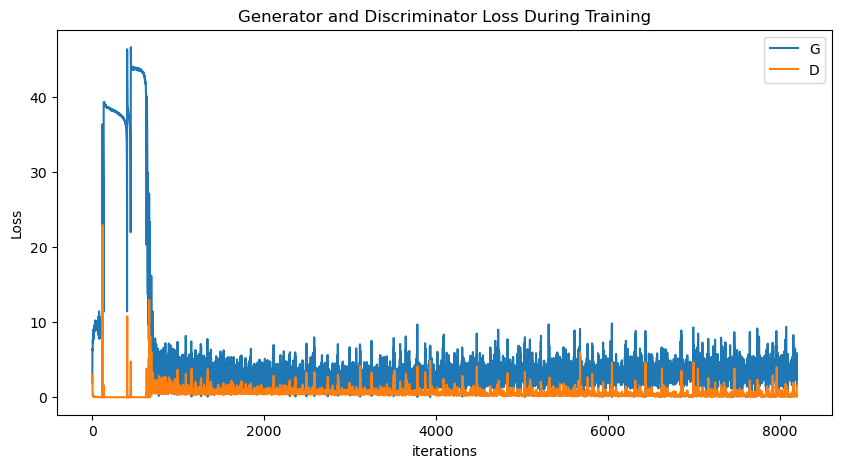

In [31]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

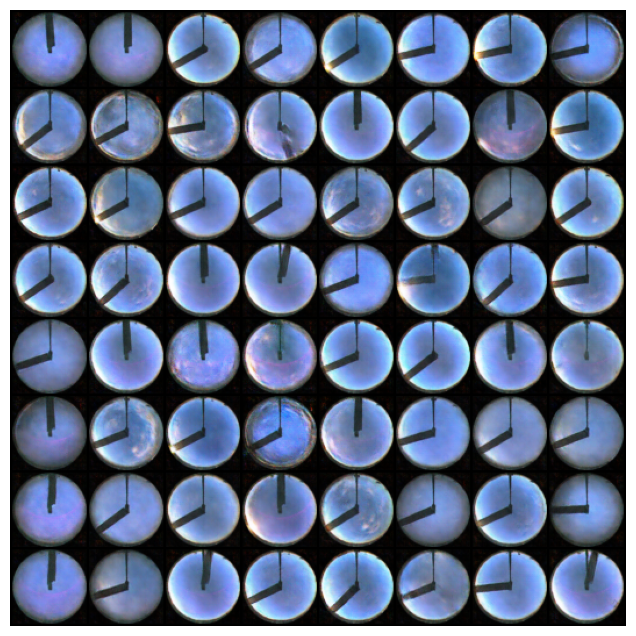

In [32]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())